## Clustering QC

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from fastai.vision import *
import geopandas as gpd
from resizeimage import resizeimage
import datetime
import uuid
from os import listdir
from os.path import isfile, join
from PIL import Image as pil_image
import matplotlib as mpl

In [3]:
torch.cuda.set_device(1)
torch.cuda.current_device()

1

In [71]:
data_dir = Path('data')
train_images=data_dir/f'train/rotated/clipped/reflect/64'

In [5]:
DATE = datetime.datetime.today().strftime('%Y%m%d')
UID=str(uuid.uuid4())[:8]
print(f'UID: {UID}, DATE: {DATE}')                                                 

UID: e583c45a, DATE: 20191110


In [73]:
def mpl_show(new_im, label, title=''):
    plt.imshow(new_im, interpolation = 'bicubic')
    plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
    text = label+' '+title
    plt.title(text)
    plt.show()
    plt.close()

In [76]:
df_all=pd.read_csv(data_dir/'df_train_all.csv')

In [77]:
df_all=df_all.drop_duplicates(subset=['id'])

In [78]:
df_v=df_all.loc[df_all['verified'] == True]

### valid clustering

array([1, 4, 2, 3, 5])

[concrete_cement, irregular_metal, healthy_metal, incomplete, other]

In [6]:
n2d_valid=pd.read_csv('tf/viz/caribbean_valid-n2d.csv')

In [7]:
n2d_valid.head()

,0,1,Label,id
0,3.186292,1.500005,1,7a3f2a10
1,-1.322869,0.017343,4,7a1f731e
2,-5.329446,-3.247222,2,7a424ad8
3,1.248025,3.793701,2,7a3edc5e
4,1.578806,3.655826,2,7a303a6e


In [8]:
len(n2d_valid)

14870

In [9]:
vx=n2d_valid['0'].values.tolist()
vy=n2d_valid['1'].values.tolist()
vlabel=n2d_valid.Label.values.tolist()

In [12]:
vnhm=n2d_valid.loc[n2d_valid['Label'] == 2]
vxhm=vnhm['0'].values.tolist()
vyhm=vnhm['1'].values.tolist()
vlabelhm=vnhm.Label.values.tolist()

In [13]:
len(vnhm)

7381

In [15]:
vnc=n2d_valid.loc[n2d_valid['Label'] == 1]
vxc=vnc['0'].values.tolist()
vyc=vnc['1'].values.tolist()
vlabelc=vnc.Label.values.tolist()

In [16]:
len(vnc)

1387

In [18]:
vno=n2d_valid.loc[n2d_valid['Label'] == 5]
vxo=vno['0'].values.tolist()
vyo=vno['1'].values.tolist()
vlabelo=vno.Label.values.tolist()

In [19]:
vni=n2d_valid.loc[n2d_valid['Label'] == 3]
vxi=vni['0'].values.tolist()
vyi=vni['1'].values.tolist()
vlabeli=vni.Label.values.tolist()

In [20]:
vnirr=n2d_valid.loc[n2d_valid['Label'] == 4]
vxirr=vnirr['0'].values.tolist()
vyirr=vnirr['1'].values.tolist()
vlabelirr=vnirr.Label.values.tolist()

In [21]:
len(vnirr)

5241

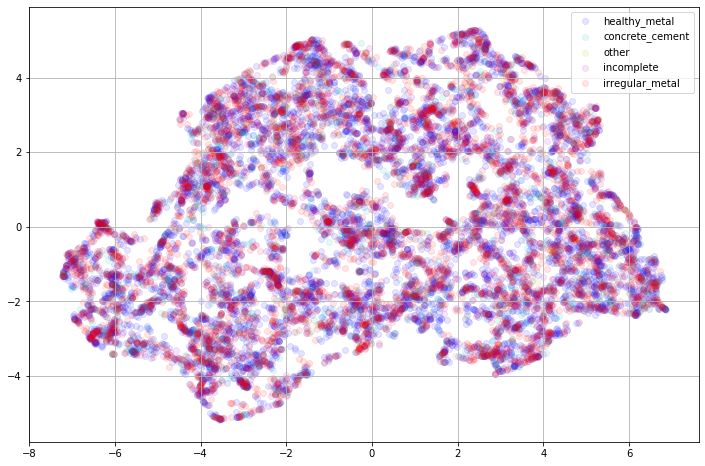

In [22]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(12, 8)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(vxhm, vyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
concrete_cement=plt.scatter(vxc, vyc, c=colors[1], alpha = 0.1, label='concrete_cement')
other=plt.scatter(vxo, vyo, c=colors[2], alpha = 0.1, label='other')
incomplete=plt.scatter(vxi, vyi, c=colors[3], alpha = 0.1, label='incomplete')
irregular_metal=plt.scatter(vxirr, vyirr, c=colors[4], alpha = 0.1, label='irregular_metal')
plt.grid(True)
plt.legend()
plt.show()

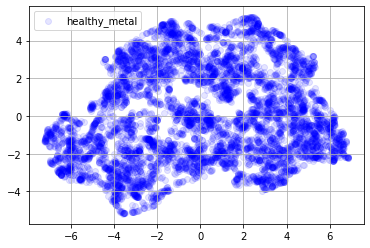

In [23]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(6, 4)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(vxhm, vyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
plt.grid(True)
plt.legend()
plt.show()


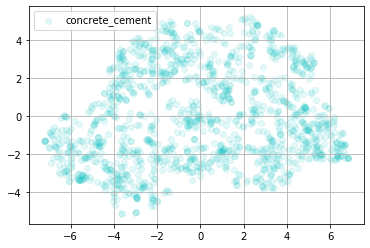

In [24]:
concrete_cement=plt.scatter(vxc, vyc, c=colors[1], alpha = 0.1, label='concrete_cement')
plt.grid(True)
plt.legend()
plt.show()

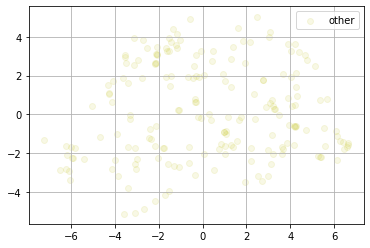

In [25]:
other=plt.scatter(vxo, vyo, c=colors[2], alpha = 0.1, label='other')
plt.grid(True)
plt.legend()
plt.show()

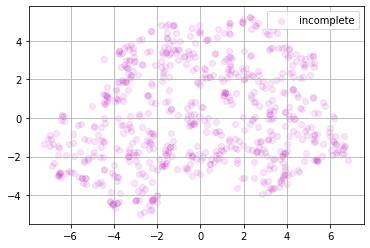

In [26]:
incomplete=plt.scatter(vxi, vyi, c=colors[3], alpha = 0.1, label='incomplete')
plt.grid(True)
plt.legend()
plt.show()

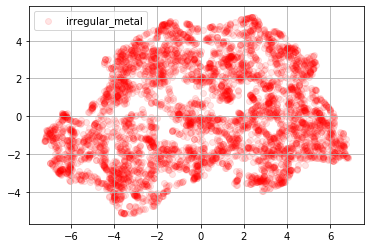

In [27]:
irregular_metal=plt.scatter(vxirr, vyirr, c=colors[4], alpha = 0.1, label='irregular_metal')
plt.grid(True)
plt.legend()
plt.show()

In [70]:
sector_1 = n2d_valid.loc[(n2d_valid['0'] < -6) & ( n2d_valid['0'] > -8) & ( n2d_valid['1'] > -2) & ( n2d_valid['1'] < 0)]

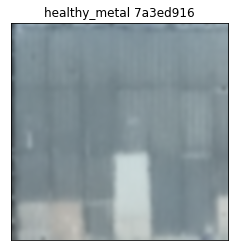

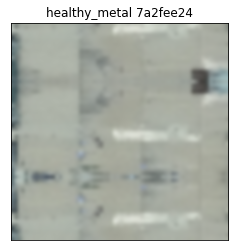

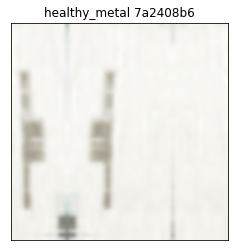

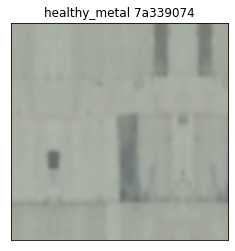

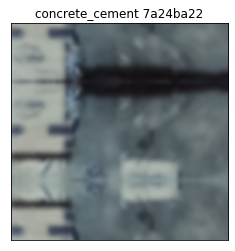

...

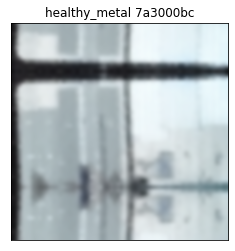

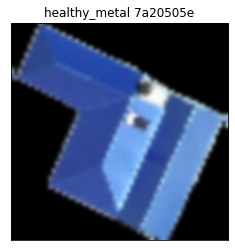

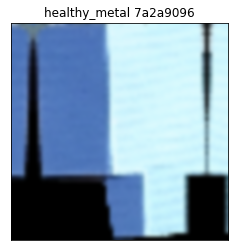

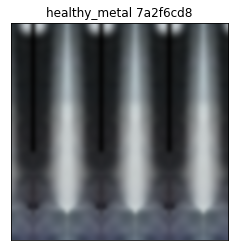

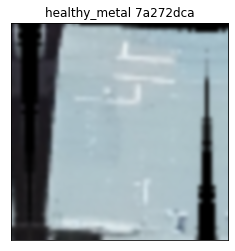

In [80]:
for id in sector_1['id']:
    roof=df_v.loc[df_v['id'] == id, 'roof_material'].iloc[0]
    im = pil_image.open(train_images/f'{id}.tif')
    mpl_show(im,roof, id)

### invalid clustering

In [28]:
n2d_invalid=pd.read_csv('tf/viz/caribbean_invalid-n2d.csv')

In [29]:
n2d_invalid.head()

,0,1,Label,id
0,0.636243,1.440195,2,7a24bd7e
1,2.126418,5.135915,2,7a2cf00c
2,3.831535,-2.263464,2,7a3975e8
3,-4.692235,3.591974,2,7a1d215e
4,-2.456989,3.651371,2,7a42475e


In [34]:
len(n2d_invalid)

7683

In [35]:
#sector_1 = tsne_data.loc[(tsne_data['x'] > -2) & ( tsne_data['x'] < 2) & ( tsne_data['y'] > 0) & ( tsne_data['y'] < 5)]

In [36]:
#from IPython.display import Image, display
#for id in sector_1['id']:
#    display(Image(filename='plots/clustering/{0}.png'.format(id)))
#    print(id)

In [37]:
ix=n2d_invalid['0'].values.tolist()
iy=n2d_invalid['1'].values.tolist()
ilabel=n2d_invalid.Label.values.tolist()

In [38]:
inhm=n2d_invalid.loc[n2d_invalid['Label'] == 2]
ixhm=inhm['0'].values.tolist()
iyhm=inhm['1'].values.tolist()
ilabelhm=inhm.Label.values.tolist()

In [39]:
len(inhm)

7436

In [40]:
inc=n2d_invalid.loc[n2d_invalid['Label'] == 1]
ixc=inc['0'].values.tolist()
iyc=inc['1'].values.tolist()
ilabelc=inc.Label.values.tolist()

In [41]:
len(inc)

131

In [42]:
ino=n2d_invalid.loc[n2d_invalid['Label'] == 4]
ixo=ino['0'].values.tolist()
iyo=ino['1'].values.tolist()
ilabelo=ino.Label.values.tolist()

In [43]:
ini=n2d_invalid.loc[n2d_invalid['Label'] == 3]
ixi=ini['0'].values.tolist()
iyi=ini['1'].values.tolist()
ilabeli=ini.Label.values.tolist()

<pre>
[2, 1, 4, 3]
[healthy_metal, concrete_cement, other, incomplete]
</pre>

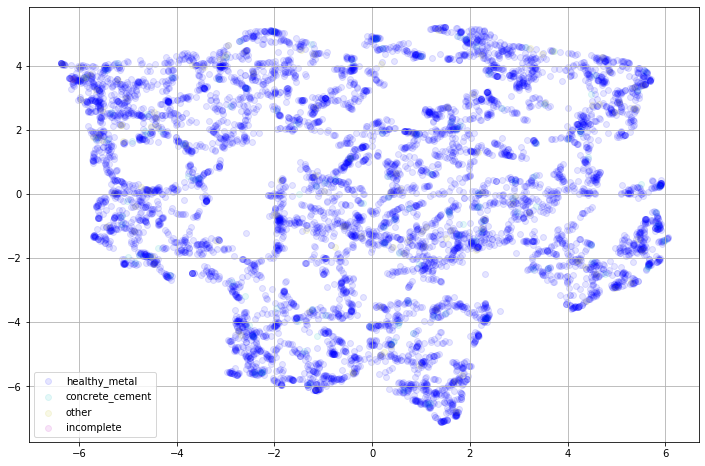

In [44]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(12, 8)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(ixhm, iyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
concrete_cement=plt.scatter(ixc, iyc, c=colors[1], alpha = 0.1, label='concrete_cement')
other=plt.scatter(ixo, iyo, c=colors[2], alpha = 0.1, label='other')
incomplete=plt.scatter(ixi, iyi, c=colors[3], alpha = 0.1, label='incomplete')
plt.grid(True)
plt.legend()
plt.show()

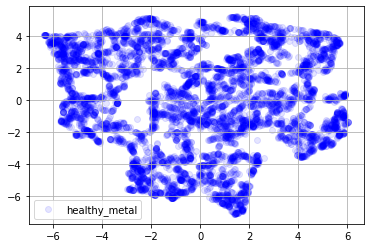

In [45]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(6, 4)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(ixhm, iyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
plt.grid(True)
plt.legend()
plt.show()


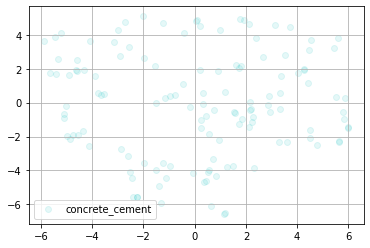

In [46]:
concrete_cement=plt.scatter(ixc, iyc, c=colors[1], alpha = 0.1, label='concrete_cement')
plt.grid(True)
plt.legend()
plt.show()

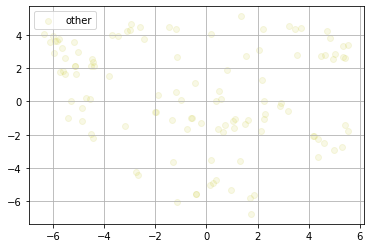

In [47]:
other=plt.scatter(ixo, iyo, c=colors[2], alpha = 0.1, label='other')
plt.grid(True)
plt.legend()
plt.show()

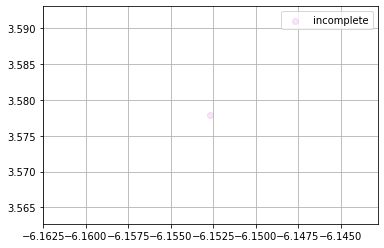

In [48]:
incomplete=plt.scatter(ixi, iyi, c=colors[3], alpha = 0.1, label='incomplete')
plt.grid(True)
plt.legend()
plt.show()

### test clustering



array([2, 4, 1, 3, 5])

[healthy_metal, irregular_metal, concrete_cement, incomplete, other]

In [49]:
n2d_test=pd.read_csv('tf/viz/caribbean_test-n2d.csv')

In [50]:
n2d_test.head()

,0,1,Label,id
0,3.339864,3.658237,2,7a4d630a
1,1.434726,0.235382,2,7a4bbbd6
2,-3.207816,-3.154887,2,7a4ac744
3,1.168088,-2.022339,4,7a4881fa
4,-4.037225,-4.232945,2,7a4aa4a8


In [53]:
len(n2d_test)

7325

In [54]:
tx=n2d_test['0'].values.tolist()
ty=n2d_test['1'].values.tolist()
tlabel=n2d_test.Label.values.tolist()
set(tlabel)

{1, 2, 3, 4, 5}

In [55]:
tnhm=n2d_test.loc[n2d_test['Label'] == 2]
txhm=tnhm['0'].values.tolist()
tyhm=tnhm['1'].values.tolist()
tlabelhm=tnhm.Label.values.tolist()

In [56]:
tnc=n2d_test.loc[n2d_test['Label'] == 1]
txc=tnc['0'].values.tolist()
tyc=tnc['1'].values.tolist()
tlabelc=tnc.Label.values.tolist()

In [57]:
tnirr=n2d_test.loc[n2d_test['Label'] == 4]
txirr=tnirr['0'].values.tolist()
tyirr=tnirr['1'].values.tolist()
tlabelirr=tnirr.Label.values.tolist()

In [58]:
tni=n2d_test.loc[n2d_invalid['Label'] == 3]
txi=tni['0'].values.tolist()
tyi=tni['1'].values.tolist()
tlabeli=tni.Label.values.tolist()

In [59]:
tno=n2d_test.loc[n2d_invalid['Label'] == 5]
txo=tno['0'].values.tolist()
tyo=tno['1'].values.tolist()
tlabelo=tno.Label.values.tolist()

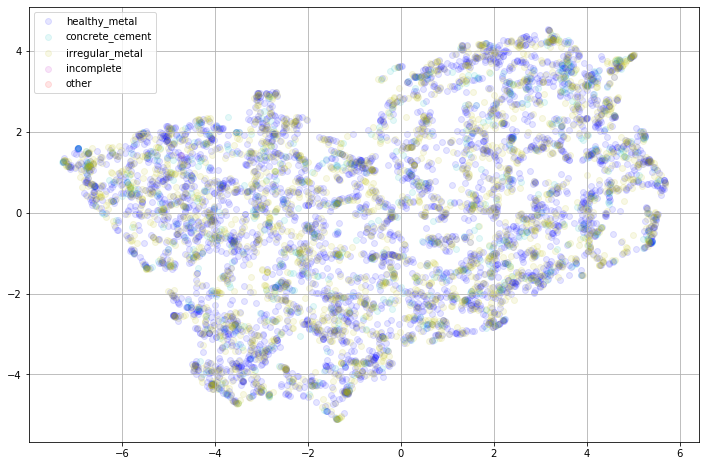

In [60]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(12, 8)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(txhm, tyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
concrete_cement=plt.scatter(txc, tyc, c=colors[1], alpha = 0.1, label='concrete_cement')
irregular_metal=plt.scatter(txirr, tyirr, c=colors[2], alpha = 0.1, label='irregular_metal')
incomplete=plt.scatter(txi, tyi, c=colors[3], alpha = 0.1, label='incomplete')
other=plt.scatter(txo, tyo, c=colors[4], alpha = 0.1, label='other')
plt.grid(True)
plt.legend()
plt.show()
plt.close()

#### cf Vaild

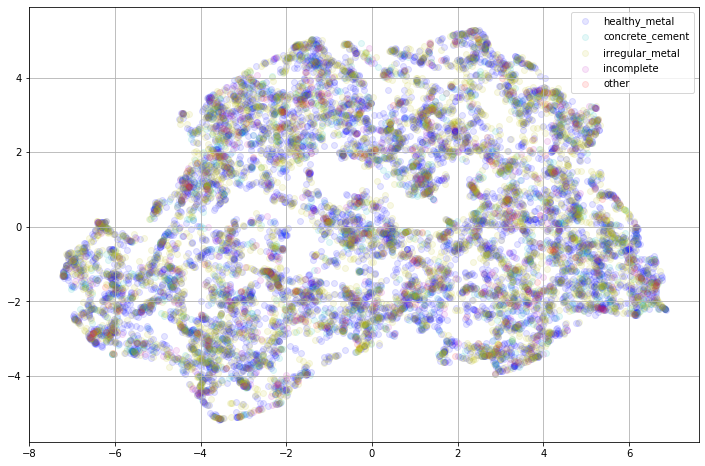

In [63]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(12, 8)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(vxhm, vyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
concrete_cement=plt.scatter(vxc, vyc, c=colors[1], alpha = 0.1, label='concrete_cement')
irregular_metal=plt.scatter(vxirr, vyirr, c=colors[2], alpha = 0.1, label='irregular_metal')
incomplete=plt.scatter(vxi, vyi, c=colors[3], alpha = 0.1, label='incomplete')
other=plt.scatter(vxo, vyo, c=colors[4], alpha = 0.1, label='other')
plt.grid(True)
plt.legend()
plt.show()
plt.close()

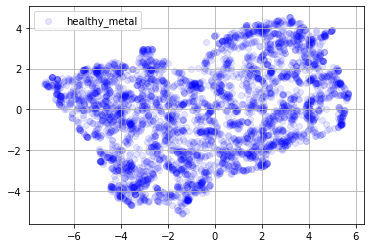

In [64]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(6, 4)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(txhm, tyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
plt.grid(True)
plt.legend()
plt.show()


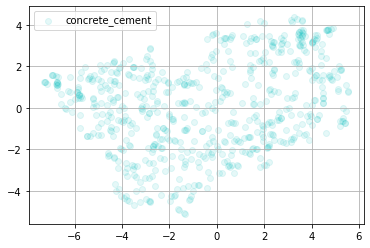

In [65]:
concrete_cement=plt.scatter(txc, tyc, c=colors[1], alpha = 0.1, label='concrete_cement')
plt.grid(True)
plt.legend()
plt.show()

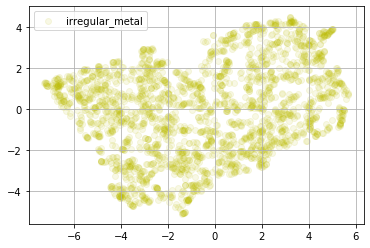

In [66]:
irregular_metal=plt.scatter(txirr, tyirr, c=colors[2], alpha = 0.1, label='irregular_metal')
plt.grid(True)
plt.legend()
plt.show()

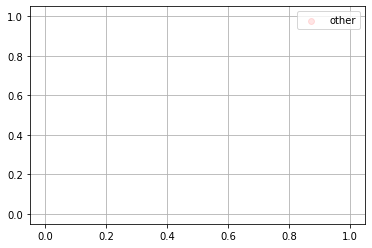

In [67]:
other=plt.scatter(txo, tyo, c=colors[4], alpha = 0.1, label='other')
plt.grid(True)
plt.legend()
plt.show()

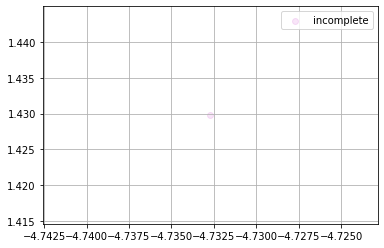

In [68]:
incomplete=plt.scatter(txi, tyi, c=colors[3], alpha = 0.1, label='incomplete')
plt.grid(True)
plt.legend()
plt.show()

### predicted invalid with cutoffs

### invalid clustering

In [83]:
df_pred_invalid=pd.read_csv(data_dir/'pred_invalid_cutoffs-rn50-03_15-cv_reflect_101_valid_cf_verified-20191110-57d55570.csv')

In [84]:
df_pred_invalid.head()

,id,concrete_cement,healthy_metal,incomplete,irregular_metal,other,pred,confidence
0,7a24bd7e,0.008806,0.913176,0.002267,0.007207,0.068543,healthy_metal,0.913176
1,7a2cf00c,0.001045,0.994259,0.000526,0.003511,0.000659,healthy_metal,0.994259
2,7a3975e8,0.001082,0.976426,0.000773,0.020468,0.001251,healthy_metal,0.976426
3,7a1d215e,0.000703,0.985209,0.000670,0.002442,0.010977,healthy_metal,0.985209
4,7a42475e,0.014385,0.973137,0.001237,0.008855,0.002385,healthy_metal,0.973137


In [85]:
len(df_pred_invalid)

7250

In [87]:
pred_ids=df_pred_invalid['id'].values.tolist()

In [99]:
#### NB not the predicted - is show low confidence ones

In [100]:
cutoff_pred_invalid=n2d_invalid[~n2d_invalid['id'].isin(pred_ids)]

In [101]:
len(cutoff_pred_invalid)

433

In [102]:
pix=cutoff_pred_invalid['0'].values.tolist()
piy=cutoff_pred_invalid['1'].values.tolist()
pilabel=cutoff_pred_invalid.Label.values.tolist()

In [103]:
pinhm=cutoff_pred_invalid.loc[cutoff_pred_invalid['Label'] == 2]
pixhm=pinhm['0'].values.tolist()
piyhm=pinhm['1'].values.tolist()
pilabelhm=pinhm.Label.values.tolist()

In [104]:
len(pinhm)

328

In [105]:
pinc=cutoff_pred_invalid.loc[cutoff_pred_invalid['Label'] == 1]
pixc=pinc['0'].values.tolist()
piyc=pinc['1'].values.tolist()
pilabelc=pinc.Label.values.tolist()

In [106]:
len(pinc)

44

In [107]:
pino=cutoff_pred_invalid.loc[cutoff_pred_invalid['Label'] == 4]
pixo=pino['0'].values.tolist()
piyo=pino['1'].values.tolist()
pilabelo=pino.Label.values.tolist()

In [108]:
pini=cutoff_pred_invalid.loc[cutoff_pred_invalid['Label'] == 3]
pixi=pini['0'].values.tolist()
piyi=pini['1'].values.tolist()
pilabeli=pini.Label.values.tolist()

<pre>
[2, 1, 4, 3]
[healthy_metal, concrete_cement, other, incomplete]
</pre>

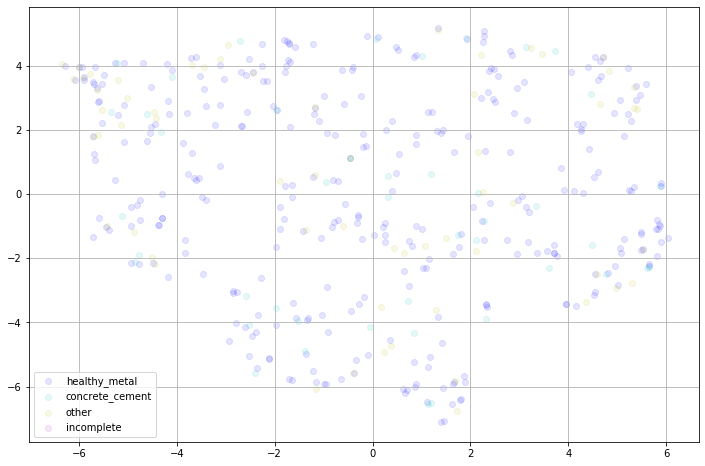

In [109]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(12, 8)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(pixhm, piyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
concrete_cement=plt.scatter(pixc, piyc, c=colors[1], alpha = 0.1, label='concrete_cement')
other=plt.scatter(pixo, piyo, c=colors[2], alpha = 0.1, label='other')
incomplete=plt.scatter(pixi, piyi, c=colors[3], alpha = 0.1, label='incomplete')
plt.grid(True)
plt.legend()
plt.show()

cf invalid

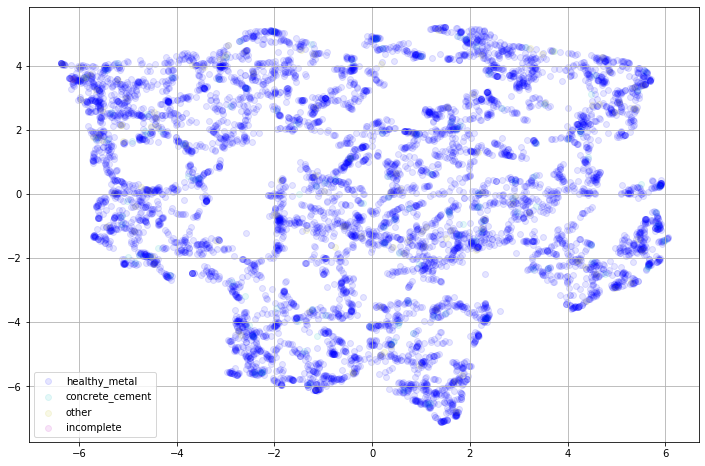

In [98]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(12, 8)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(ixhm, iyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
concrete_cement=plt.scatter(ixc, iyc, c=colors[1], alpha = 0.1, label='concrete_cement')
other=plt.scatter(ixo, iyo, c=colors[2], alpha = 0.1, label='other')
incomplete=plt.scatter(ixi, iyi, c=colors[3], alpha = 0.1, label='incomplete')
plt.grid(True)
plt.legend()
plt.show()

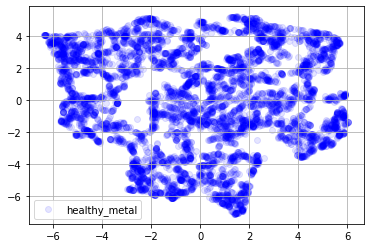

In [45]:
fig = mpl.pyplot.gcf()
fig.set_size_inches(6, 4)

colors = ['b', 'c', 'y', 'm', 'r']

healthy_metal=plt.scatter(ixhm, iyhm, c=colors[0], alpha = 0.1, label='healthy_metal')
plt.grid(True)
plt.legend()
plt.show()


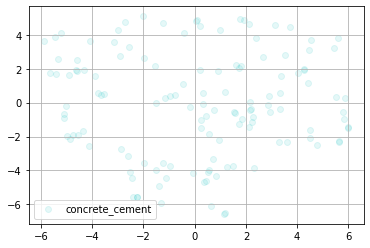

In [46]:
concrete_cement=plt.scatter(ixc, iyc, c=colors[1], alpha = 0.1, label='concrete_cement')
plt.grid(True)
plt.legend()
plt.show()

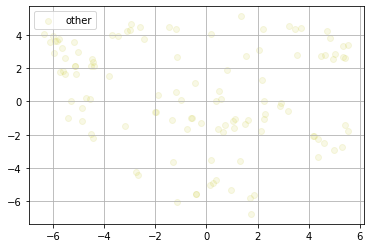

In [47]:
other=plt.scatter(ixo, iyo, c=colors[2], alpha = 0.1, label='other')
plt.grid(True)
plt.legend()
plt.show()

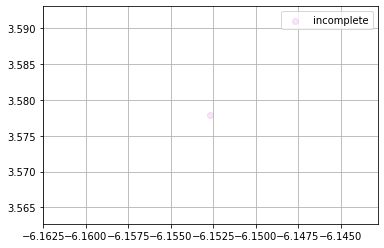

In [48]:
incomplete=plt.scatter(ixi, iyi, c=colors[3], alpha = 0.1, label='incomplete')
plt.grid(True)
plt.legend()
plt.show()

Summary, no significant trends in clustering that seem obvious to me, try GAN clustering as aternativde

In [ ]:
pred_invalid_cutoffs-rn50-03_15-cv_reflect_101_valid_cf_verified-20191110-57d55570

In [94]:
im = pil_image.open(train_images/'7a295212.tif')

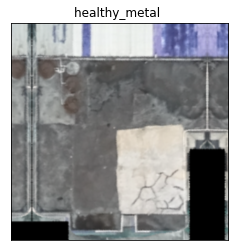

In [96]:
mpl_show(im, 'healthy_metal')

In [98]:
im = pil_image.open(train_images/'7a26dfa0.tif')

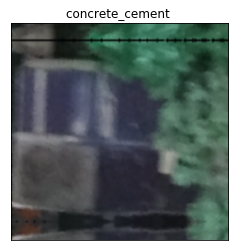

In [99]:
mpl_show(im, 'concrete_cement')